## **Comunidades!**
¿Cómo podemos reconocer (con un espíritu no-supervisado) **[grupos de nodos densamente conectados en un grafo $G$, que al mismo tiempo establecen pocas conexiones con otros grupos?](https://arxiv.org/pdf/0906.0612.pdf)** ¿Qué **medidas o conceptos** podemos utilizar? ¿Qué **significados** tienen estas medidas en un contexto en particular? Es habitual en Ciencia de Redes establecer una sinergia entre dos maneras de mirar un mismo problema:

- la **búsqueda de medidas en Teoría de Grafos** que nos permitan decir cosas sobre una red (que representa algo del mundo).
- la **re-interpretación de las medidas utilizadas**, y cómo estas interpretaciones nos podrían servir para otros contextos. 

### **1. Preliminares: grafos de similaridad lingüística :)**

Como hemos visto en clases anteriores, consideremos datos formados por un conjunto de puntos $x_1,...,x_n$. Sobre este conjunto, definimos **alguna noción de similaridad (o distancia)** entre pares $x_i$ y $x_j$ como $s_{ij}$. Una forma útil de representar esta situación es a través de un **grafo de similaridad (distancia)** $G=(V,E)$, donde el conjunto $V$ representa el conjunto de puntos, y $E$ define distancias entre puntos. Existen diversas opciones para definir $E$:

- **$\epsilon$-graph:** unimos dos puntos $x_i$ y $x_j$ si $s_{ij}<\epsilon$.  
- **$k$-nearest graph:** cada punto $x_i$ se une a los $k$ puntos más cercanos. 
- **complete graph:** cada par de puntos $x_i$ y $x_j$ se une con una arista con un peso igual a $s_{ij}$.

**Pensemos (nuevamente) en lenguas y datos.** Existen muchas bases de datos lingüísticas, por ejemplo [SAILS](https://sails.clld.org/) o [WALS](https://wals.info/), en donde cada lengua -digamos $L$- se representa por un conjunto de rasgos $r_1^L,...,r_m^L$. Cada rasgo $r_i^L$, además, tiene un valor (en general, numérico). Estos rasgos han sido registrados por expertas y expertos. 

En términos más precisos, **$L$ se representa por un vector ordenado de números:** ¿Cómo podemos **comparar** lenguas y responder, por ejemplo, las maneras en que las lenguas se agrupan en **familias**? ¿En cuánto se parece el **mapundungun** con el **quechua**? En este taller, nos proponemos definir un **grafo de similaridad $G=(V,E)$**, donde **$V$ es un conjunto de lenguas** y **$E$ es un conjunto de aristas que registran similaridades entre pares de lenguas.** 

### **2. Datos**

Tenemos datos de dos tipos: familias lingüísticas de América del Sur, redes de similaridad entre lenguas pertenecientes a tales familias. 

In [1]:
## familias lingüísticas
import pickle

id_family=pickle.load(open('id_family.p','rb'))

In [2]:
### leemos los datos

import networkx as nx

graphs=pickle.load(open('graphs.p','rb'))

In [3]:
graphs

{30: {3: <networkx.classes.graph.Graph at 0x7f758c5e4748>,
  4: <networkx.classes.graph.Graph at 0x7f758f6f90f0>,
  5: <networkx.classes.graph.Graph at 0x7f758f6d9f28>,
  6: <networkx.classes.graph.Graph at 0x7f756210ee48>,
  7: <networkx.classes.graph.Graph at 0x7f758c4a8860>},
 40: {3: <networkx.classes.graph.Graph at 0x7f7598564d30>,
  4: <networkx.classes.graph.Graph at 0x7f758c5e4898>,
  5: <networkx.classes.graph.Graph at 0x7f758c5e4710>,
  6: <networkx.classes.graph.Graph at 0x7f758c5d39e8>,
  7: <networkx.classes.graph.Graph at 0x7f758c5bb978>},
 50: {3: <networkx.classes.graph.Graph at 0x7f758c5d9128>,
  4: <networkx.classes.graph.Graph at 0x7f7565089ef0>,
  5: <networkx.classes.graph.Graph at 0x7f7565089160>,
  6: <networkx.classes.graph.Graph at 0x7f7565089f28>,
  7: <networkx.classes.graph.Graph at 0x7f7564a2d710>},
 60: {3: <networkx.classes.graph.Graph at 0x7f7564a2d7b8>,
  4: <networkx.classes.graph.Graph at 0x7f7564a2d780>,
  5: <networkx.classes.graph.Graph at 0x7f7564

In [4]:
!pip install pydot

You should consider upgrading via the '/home/ec2-user/anaconda3/envs/python3/bin/python -m pip install --upgrade pip' command.


In [5]:
!pip install python-louvain

  Created wheel for python-louvain: filename=python_louvain-0.14-py3-none-any.whl size=9291 sha256=005526203ec61620080bbc92d438198637be1d0e033547eab24d7dfa4f6a5ce1
  Stored in directory: /home/ec2-user/.cache/pip/wheels/d5/54/b7/9a703ffb0734ba1cdce4b827b2f07ed05e3108d76b32b9f510
Successfully built python-louvain
You should consider upgrading via the '/home/ec2-user/anaconda3/envs/python3/bin/python -m pip install --upgrade pip' command.


In [6]:
import community as community_louvain

In [7]:
## visualicemos los grafos!

import matplotlib.pyplot as plt

def plotG(G):
    fig, ax = plt.subplots(dpi=1080)
    
    #partition = community_louvain.best_partition(G,weight='none',partition={key:id_family[key] for key in G.nodes()})

    pos = nx.nx_pydot.graphviz_layout(G)#nx.kamada_kawai_layout(G)
    ## 
    nodesA = [node for node in G.nodes() if id_family[node]=='araw1281']
    nodesM = [node for node in G.nodes() if id_family[node]=='maya1287']
    nodesQ = [node for node in G.nodes() if id_family[node]=='quec1387']
    nodesP = [node for node in G.nodes() if id_family[node]=='pano1259']
    nodesO = [node for node in G.nodes() if id_family[node]=='otom1299']
    nodesT = [node for node in G.nodes() if id_family[node]=='tupi1275']
    nodesN = [node for node in G.nodes() if id_family[node]=='nucl1710']
    nodesC = [node for node in G.nodes() if id_family[node]=='cari1283']
    nodesU = [node for node in G.nodes() if id_family[node]=='utoa1244']
    nodesCh= [node for node in G.nodes() if id_family[node]=='chib1249']
    nodesB= [node for node in G.nodes() if id_family[node]=='barb1265']
    nodesAy= [node for node in G.nodes() if id_family[node]=='ayma1253']
    nodesAr= [node for node in G.nodes() if id_family[node]=='arau1255']
    nodesCho= [node for node in G.nodes() if id_family[node]=='chon1288']
    nodesMa= [node for node in G.nodes() if id_family[node]=='mata1289']
    nodesGu= [node for node in G.nodes() if id_family[node]=='guai1249']
    nodesZa= [node for node in G.nodes() if id_family[node]=='zamu1243']

    #nodesnonA = [node for node in G.nodes() if id_family[node] not in ['araw1281','maya1287','quec1387','pano1259','otom1299','tupi1275','nucl1710','cari1283','utoa1244']]
    
    nx.draw_networkx_nodes(G, pos, nodelist=nodesA, node_size = 40, node_color='orange',node_shape='H',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='araw1281') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesM, node_size = 40, node_color='m',node_shape='X', markeredgecolor='k',alpha=0.95,fillstyle='full',linewidths=0.1,label='maya1287') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesQ, node_size = 40, node_color='b',node_shape='o',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='quec1387') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesP, node_size = 40, node_color='r',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='pano1259') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesO, node_size = 40, node_color='cyan',node_shape='D',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='otom1299') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesT, node_size = 40, node_color='yellow',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='tupi1275') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesN, node_size = 40, node_color='green',node_shape='^',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='nucl1710') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesC, node_size = 40, node_color='olive',node_shape='v',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='cari1283') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesU, node_size = 40, node_color='lime',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='utoa1244') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCh, node_size = 40, node_color='crimson',node_shape='<',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chib1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesB, node_size = 40, node_color='chocolate',node_shape='>',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='barb1265') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAy, node_size = 40, node_color='slategrey',node_shape='d',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='ayma1253') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAr, node_size = 40, node_color='fuchsia',node_shape='8',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='arau1255') 
    ##
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCho, node_size = 40, node_color='palegreen',node_shape='h',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chon1288') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesMa, node_size = 40, node_color='steelblue',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='mata1289') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesGu, node_size = 40, node_color='salmon',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='guai1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesZa, node_size = 40, node_color='gold',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='zamu1243') 

    nx.draw_networkx_edges(G, pos, alpha=0.5,width=0.15,edge_color='lightblue')
    #labels=partition
    #nx.draw_networkx_labels(G,pos,labels,alpha=0.95,font_size=4,font_color='k',font_family='monospace')
    #plt.title(str(num_rasgos)+' features'+', '+str(len(G))+' languages and '+str(knn)+' nearest neighbors',fontsize=10)
    plt.legend(loc='best',fontsize=5)
    plt.axis('off')
    #plt.savefig('GRAPHS/graph_knn_'+str(num_rasgos)+'_'+str(knn)+'.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=1080)
    plt.show()

In [8]:
G=graphs[50][5]

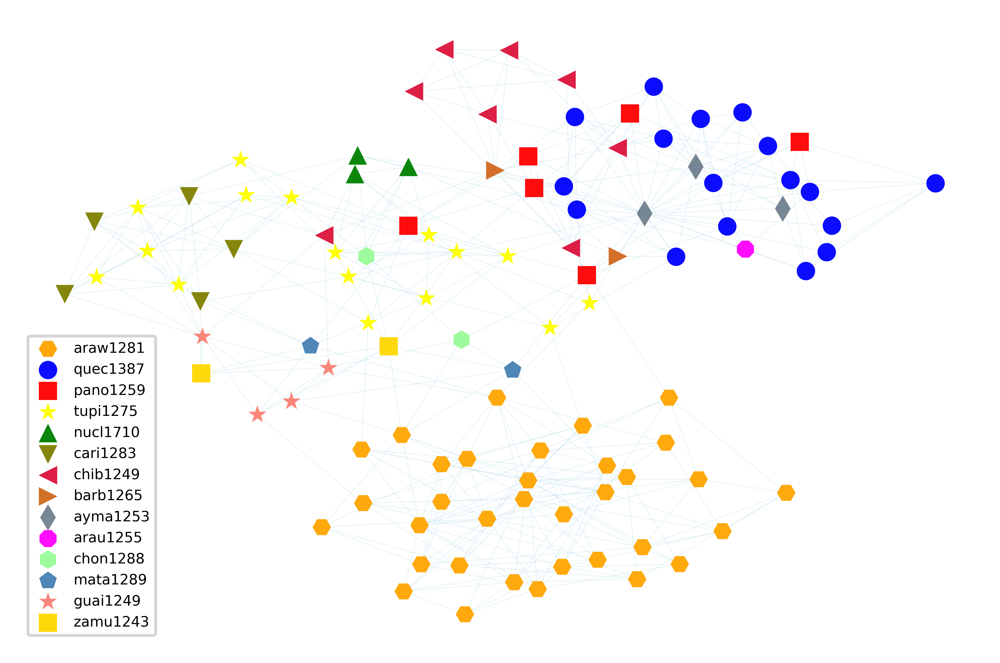

In [9]:
plotG(G)

### **3. Un primer método simple!**

Una primera aproximación a encontrar grupos de nodos relacionados entre sí es **particionar el grafo**. Para esto, buscamos el conjunto mínimo de aristas que **corta** el grafo en componentes conexas. Por cierto, esto puede traer problemas, como veremos :)

In [10]:
G=graphs[50][5]
G0=G.copy()

In [11]:
edges=nx.minimum_edge_cut(G0)

In [12]:
edges

{('mapu1245', 'caja1238'),
 ('mapu1245', 'jaqa1244'),
 ('mapu1245', 'nort2980'),
 ('mapu1245', 'sout2996'),
 ('mapu1245', 'tena1240')}

In [13]:
G0.remove_edges_from(edges)

In [14]:
nx.number_connected_components(G0)

2

In [15]:
smallest_cc = min(nx.connected_components(G0), key=len)

In [16]:
smallest_cc

{'mapu1245'}

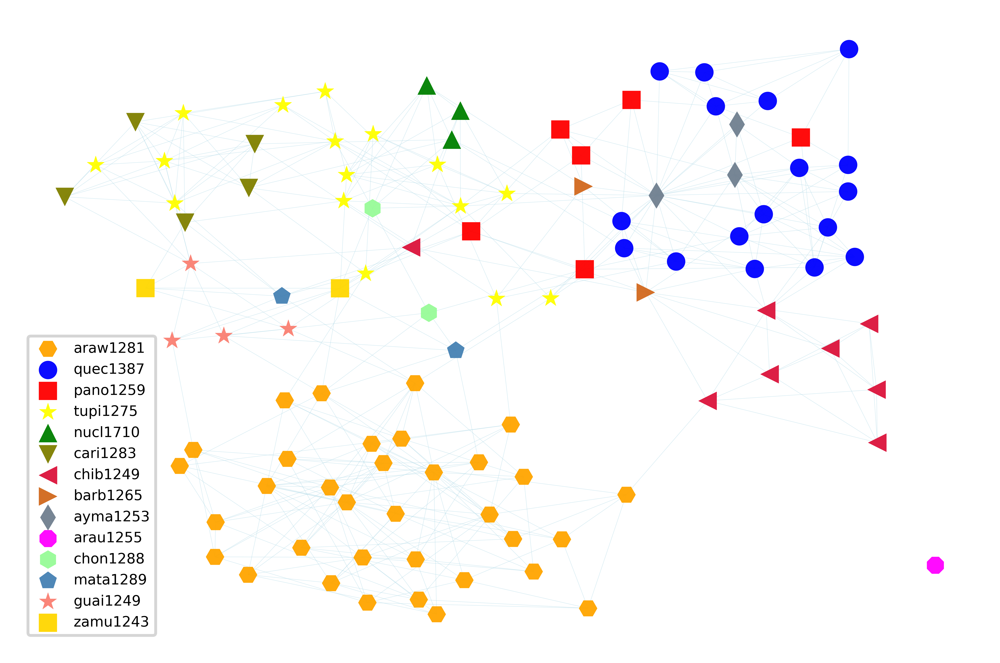

In [17]:
plotG(G0)

### **4. Girvan-Newman: un ejemplo de algoritmo divisivo**

Una manera simple de identificar **comunidades** en un grafo es **detectar aristas que conectan nodos en comunidades distintas y removerlas.** De esta forma, las comunidades se desconectan entre sí. Esta es la **filosofía de los algoritmos divisivos:** debemos encontrar una manera (calculable y simple) de identificar tales aristas. 

Para el algoritmo de [Girvan-Newman](https://www.pnas.org/content/99/12/7821), la **importancia** de las aristas se ve a través de la **edge-centrality.** Los pasos del algoritmo se describen a continuación:

1. calculamos la centralidad de todas las aristas del grafo
2. removemos la arista de mayor centralidad; en caso de empate, elegimos al azar
3. recalculamos la centralidad para el grafo podado
4. volvemos al paso 2. 

**Edge-centrality** es entendida según **edge betweenness**, definida como el número de caminos mínimos entre todos los pares de nodos del grafo que pasan por una arista específica. 

In [129]:
from networkx.algorithms import community

In [139]:
G = graphs[50][5]

communities_generator = community.girvan_newman(G)

In [140]:
import itertools

list_labels = []
modularity = []
size_com = []
K = 4

for communities in itertools.islice(communities_generator, K):
    
    labels_nodes = {}
    tuple_com = tuple(sorted(c) for c in communities)
    M = community.modularity(G, tuple_com)
    modularity.append(M)
    k = len(tuple_com)
    size_com.append(k)

    for i in range(k):
        label = tuple_com[i]
        for node in label:
            labels_nodes[node]=i
    list_labels.append(labels_nodes)

In [141]:
modularity

[0.4276576545666575,
 0.5965683726678312,
 0.6074765019662846,
 0.6106447533250705]

In [142]:
len(list_labels)

4

In [143]:
size_com

[2, 3, 4, 5]

In [144]:
def plot_GN(G,labels,clusters):
    fig, ax = plt.subplots(dpi=1080)
    
    #partition = community_louvain.best_partition(G,weight='none',partition={key:id_family[key] for key in G.nodes()})

    pos = nx.nx_pydot.graphviz_layout(G)#nx.kamada_kawai_layout(G)
    ## 
    nodesA = [node for node in G.nodes() if id_family[node]=='araw1281']
    nodesM = [node for node in G.nodes() if id_family[node]=='maya1287']
    nodesQ = [node for node in G.nodes() if id_family[node]=='quec1387']
    nodesP = [node for node in G.nodes() if id_family[node]=='pano1259']
    nodesO = [node for node in G.nodes() if id_family[node]=='otom1299']
    nodesT = [node for node in G.nodes() if id_family[node]=='tupi1275']
    nodesN = [node for node in G.nodes() if id_family[node]=='nucl1710']
    nodesC = [node for node in G.nodes() if id_family[node]=='cari1283']
    nodesU = [node for node in G.nodes() if id_family[node]=='utoa1244']
    nodesCh= [node for node in G.nodes() if id_family[node]=='chib1249']
    nodesB= [node for node in G.nodes() if id_family[node]=='barb1265']
    nodesAy= [node for node in G.nodes() if id_family[node]=='ayma1253']
    nodesAr= [node for node in G.nodes() if id_family[node]=='arau1255']
    nodesCho= [node for node in G.nodes() if id_family[node]=='chon1288']
    nodesMa= [node for node in G.nodes() if id_family[node]=='mata1289']
    nodesGu= [node for node in G.nodes() if id_family[node]=='guai1249']
    nodesZa= [node for node in G.nodes() if id_family[node]=='zamu1243']

    #nodesnonA = [node for node in G.nodes() if id_family[node] not in ['araw1281','maya1287','quec1387','pano1259','otom1299','tupi1275','nucl1710','cari1283','utoa1244']]
    
    nx.draw_networkx_nodes(G, pos, nodelist=nodesA, node_size = 40, node_color='orange',node_shape='H',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='araw1281') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesM, node_size = 40, node_color='m',node_shape='X', markeredgecolor='k',alpha=0.95,fillstyle='full',linewidths=0.1,label='maya1287') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesQ, node_size = 40, node_color='b',node_shape='o',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='quec1387') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesP, node_size = 40, node_color='r',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='pano1259') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesO, node_size = 40, node_color='cyan',node_shape='D',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='otom1299') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesT, node_size = 40, node_color='yellow',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='tupi1275') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesN, node_size = 40, node_color='green',node_shape='^',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='nucl1710') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesC, node_size = 40, node_color='olive',node_shape='v',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='cari1283') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesU, node_size = 40, node_color='lime',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='utoa1244') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCh, node_size = 40, node_color='crimson',node_shape='<',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chib1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesB, node_size = 40, node_color='chocolate',node_shape='>',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='barb1265') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAy, node_size = 40, node_color='slategrey',node_shape='d',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='ayma1253') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAr, node_size = 40, node_color='fuchsia',node_shape='8',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='arau1255') 
    ##
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCho, node_size = 40, node_color='palegreen',node_shape='h',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chon1288') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesMa, node_size = 40, node_color='steelblue',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='mata1289') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesGu, node_size = 40, node_color='salmon',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='guai1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesZa, node_size = 40, node_color='gold',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='zamu1243') 

    nx.draw_networkx_edges(G, pos, alpha=0.5,width=0.15,edge_color='lightblue')
    nx.draw_networkx_labels(G,pos,labels[clusters],alpha=0.95,font_size=4,font_color='k',font_family='monospace')
    plt.title(str(clusters+2)+' clusters',fontsize=10)
    plt.legend(loc='best',fontsize=5)
    plt.axis('off')
    plt.savefig('GRAPHS/girvan-newman_'+str(clusters+2)+'.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=1080)
    plt.show()

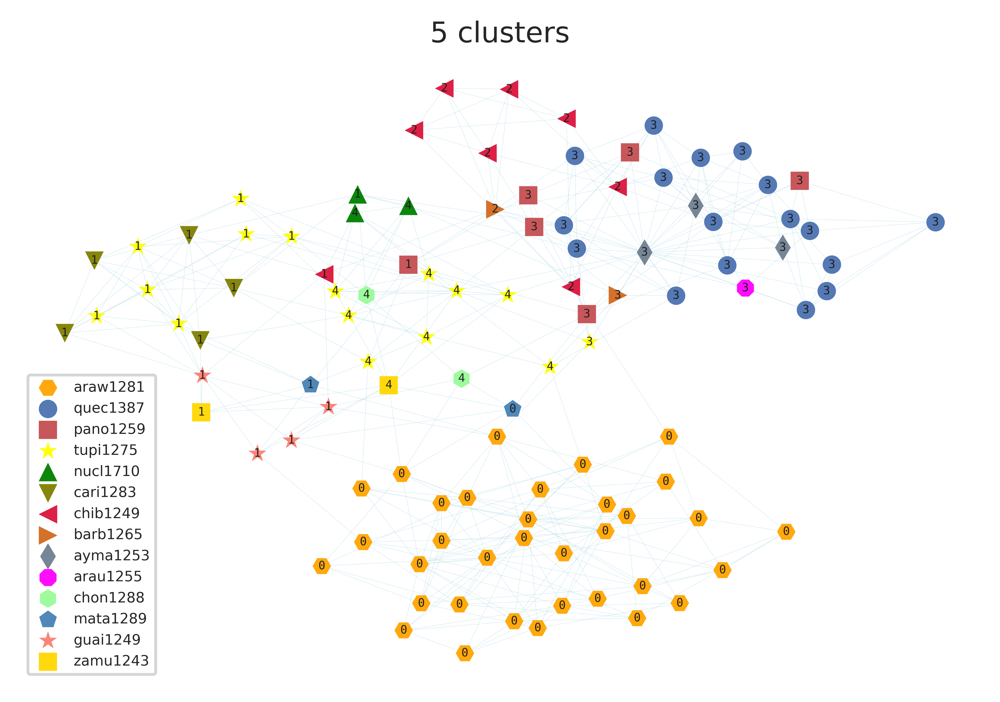

In [145]:
plot_GN(G,list_labels,3)

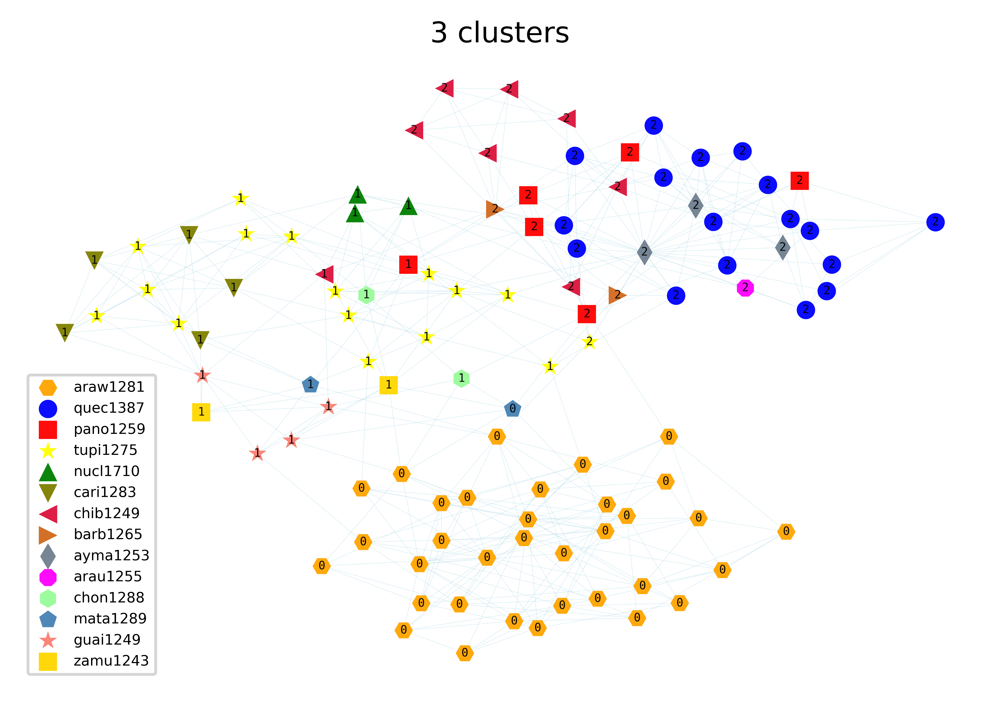

In [26]:
plot_GN(G,list_labels,1)

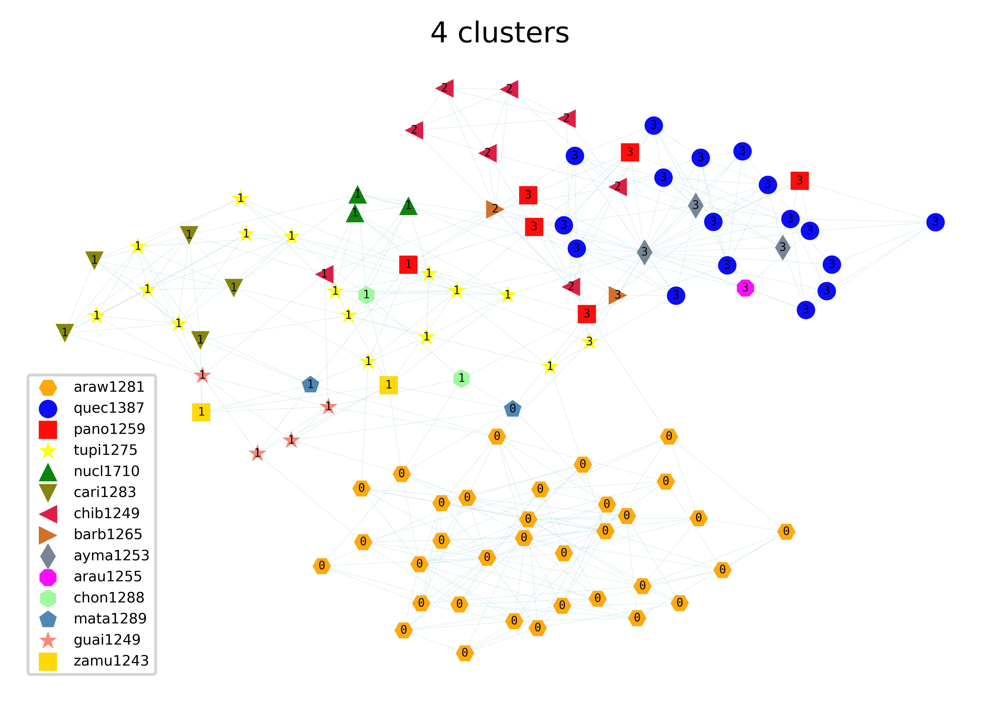

In [27]:
plot_GN(G,list_labels,2)

In [28]:
## para todos los grafos!

def GN(features,knn):
    
    G=graphs[features][knn]
    communities_generator = community.girvan_newman(G)
    list_labels = []
    modularity = []
    perf = []
    K = 9

    for communities in itertools.islice(communities_generator, K):
    
        labels_nodes = {}
        tuple_com = tuple(sorted(c) for c in communities)
        M = community.modularity(G, tuple_com)
        modularity.append(M)
        perf.append(community.coverage(G,tuple_com))
        
        k = len(tuple_com)

        for i in range(k):
            label = tuple_com[i]
            for node in label:
                labels_nodes[node]=i
        list_labels.append(labels_nodes)
    return [list_labels,modularity,perf]

In [29]:
GN_dict = {key:{} for key in graphs.keys()}

for key in graphs.keys():
    for knn in graphs[key].keys():
        GN_dict[key][knn]=GN(key,knn)

In [30]:
GN_dict[50][5][2]

[0.9636363636363636,
 0.9246753246753247,
 0.8987012987012987,
 0.8571428571428571,
 0.8337662337662337,
 0.8285714285714286,
 0.8051948051948052,
 0.7974025974025974,
 0.7480519480519481]

In [31]:
coverage_mean = []

for key in graphs.keys():
    for knn in graphs[key].keys():
        coverage_mean.append(GN_dict[key][knn][2])

In [32]:
coverage_mean = [float(sum(col))/len(col) for col in zip(*coverage_mean)]

In [33]:
coverage_mean

[0.9736242991828608,
 0.9229636174624568,
 0.8971809120611673,
 0.8683558182783987,
 0.8364623455022876,
 0.8125596861752544,
 0.7870761514879331,
 0.7625656915246225,
 0.7336689309511333]

In [34]:
coverage_all = {'clusters':[], 'coverage':[]}

for key in GN_dict.keys():
    for keykey in GN_dict[key].keys():
        for item in GN_dict[key][keykey][2]:
            coverage_all['clusters']+=[GN_dict[key][keykey][2].index(item)+2]
            coverage_all['coverage']+=[item]

In [35]:
import pandas as pd

coverage_all=pd.DataFrame.from_dict(coverage_all)

                            WLS Regression Results                            
Dep. Variable:               coverage   R-squared:                       0.844
Model:                            WLS   Adj. R-squared:                  0.843
Method:                 Least Squares   F-statistic:                     1933.
Date:                Mon, 19 Oct 2020   Prob (F-statistic):          2.24e-146
Time:                        12:50:23   Log-Likelihood:                 730.62
No. Observations:                 360   AIC:                            -1457.
Df Residuals:                     358   BIC:                            -1449.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      1.0155      0.004    238.879      0.0

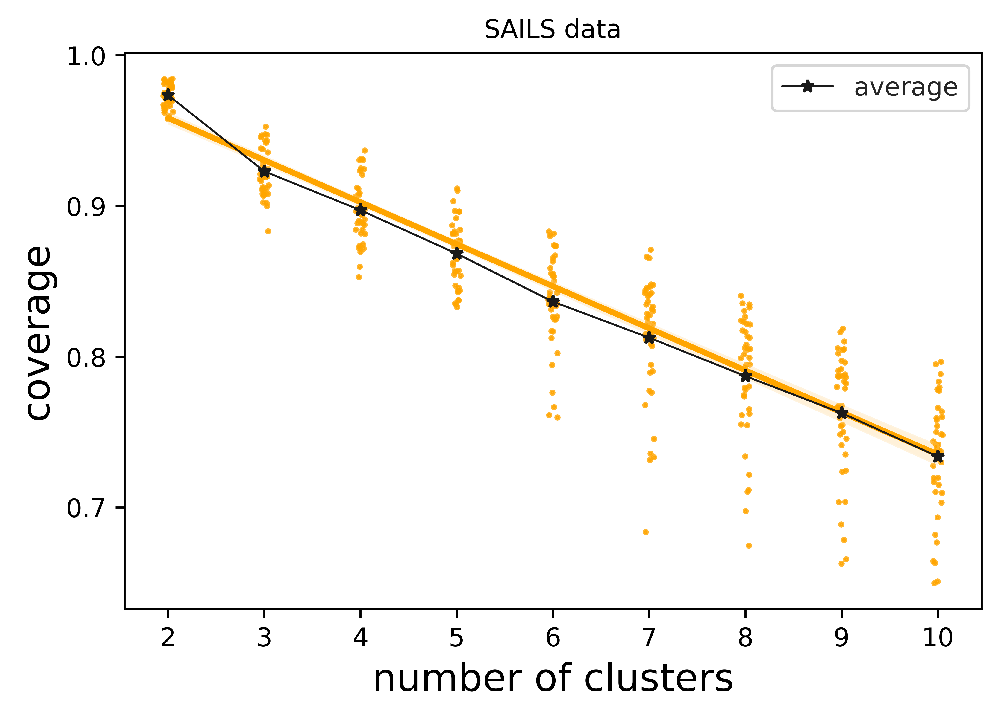

In [36]:
import statsmodels.formula.api as sm
import seaborn as sns

data=coverage_all

result = sm.wls(formula='coverage ~ clusters', data=data).fit()
print(result.summary())

fig, ax = plt.subplots(dpi=800)

sns.set(font_scale=1.5,style="white")
sns.regplot(x='clusters',y='coverage',data=data,scatter_kws={'s':2},color='orange',scatter=True,robust=True,fit_reg=True,x_jitter=.05)
ax.plot([2,3,4,5,6,7,8,9,10], coverage_mean, linewidth=0.75, linestyle='-', marker='*',color='k',markersize=5,markeredgecolor='k',markeredgewidth=1,fillstyle='full',clip_on=True,label='average')
plt.xticks([2,3,4,5,6,7,8,9,10])
plt.yticks([0.7,0.8,0.9,1.0])
#plt.yticks([0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0])
plt.title('SAILS data',fontsize=10)
plt.legend(loc='best',fontsize=10)
plt.xlabel(r'number of clusters',fontsize=15)
plt.ylabel(r'coverage',fontsize=15)
plt.savefig('coverage.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=800)
plt.rcParams.update({'font.size': 10})
plt.show()

In [37]:
def GN_random(features,knn):
    
    G=graphs[features][knn]
    G0 = G.copy()
    for i in range(int(len(G0.edges()))):
        nx.connected_double_edge_swap(G0)
    communities_generator = community.girvan_newman(G0)
    list_labels = []
    modularity = []
    
    K = 9

    for communities in itertools.islice(communities_generator, K):
    
        labels_nodes = {}
        tuple_com = tuple(sorted(c) for c in communities)
        M = community.modularity(G, tuple_com)
        modularity.append(M)
        
        k = len(tuple_com)

        for i in range(k):
            label = tuple_com[i]
            for node in label:
                labels_nodes[node]=i
        list_labels.append(labels_nodes)
    return [list_labels,modularity]

In [38]:
GN_dict_random = {key:{} for key in graphs.keys()}
for key in graphs.keys():
    for knn in graphs[key].keys():
        GN_dict_random[key][knn]=GN_random(key,knn)

In [39]:
GN_dict[50][5][1]

[0.4276576545666575,
 0.5965683726678312,
 0.6074765019662846,
 0.6106447533250705,
 0.6028195475828898,
 0.6029849584445379,
 0.5955792953233651,
 0.5928512548013077,
 0.5730331010765232]

In [40]:
GN_dict_random[50][5][1]

[-0.00035445397835183034,
 0.0019325516046607646,
 8.221856708895155e-05,
 0.008588872203053844,
 0.010091314368879455,
 0.023485670161517914,
 0.0276669131413879,
 0.024066579266928217,
 0.0201799073912026]

In [41]:
modularity = {2:[],3:[],4:[],5:[],6:[],7:[],8:[],9:[],10:[]}


for key in GN_dict.keys():
    for knn in GN_dict[key].keys():
        pair = GN_dict[key][knn][1]
        for clusters in modularity.keys():
            modularity[clusters].append(pair[clusters-2])

In [128]:
for key in modularity.keys():
    print(np.mean(modularity[key]))

0.4527140838770398
0.572068148448978
0.5888772505387782
0.5944165509197149
0.5935722526194163
0.5904522533144448
0.5847759077871364
0.5763532087507721
0.5648407559580282


In [42]:
modularity_random = {2:[],3:[],4:[],5:[],6:[],7:[],8:[],9:[],10:[]}


for key in GN_dict_random.keys():
    for knn in GN_dict_random[key].keys():
        pair = GN_dict_random[key][knn][1]
        for clusters in modularity_random.keys():
            modularity_random[clusters].append(pair[clusters-2])

In [43]:
from scipy import stats
import numpy as np

print(np.mean(modularity[2]),np.mean(modularity_random[2]))
tStat, pValue =  stats.ttest_rel(modularity[2], modularity_random[2])
print("P-Value:{0} T-Statistic:{1}".format(pValue,tStat))

0.4527140838770398 0.004743871720849632
P-Value:2.2085779368396515e-55 T-Statistic:149.14551925538495


In [44]:
print(np.mean(modularity[3]),np.mean(modularity_random[2]))
tStat, pValue =  stats.ttest_rel(modularity[3], modularity_random[3])
print("P-Value:{0} T-Statistic:{1}".format(pValue,tStat))

0.572068148448978 0.004743871720849632
P-Value:1.3622443902767574e-50 T-Statistic:112.33197418773224


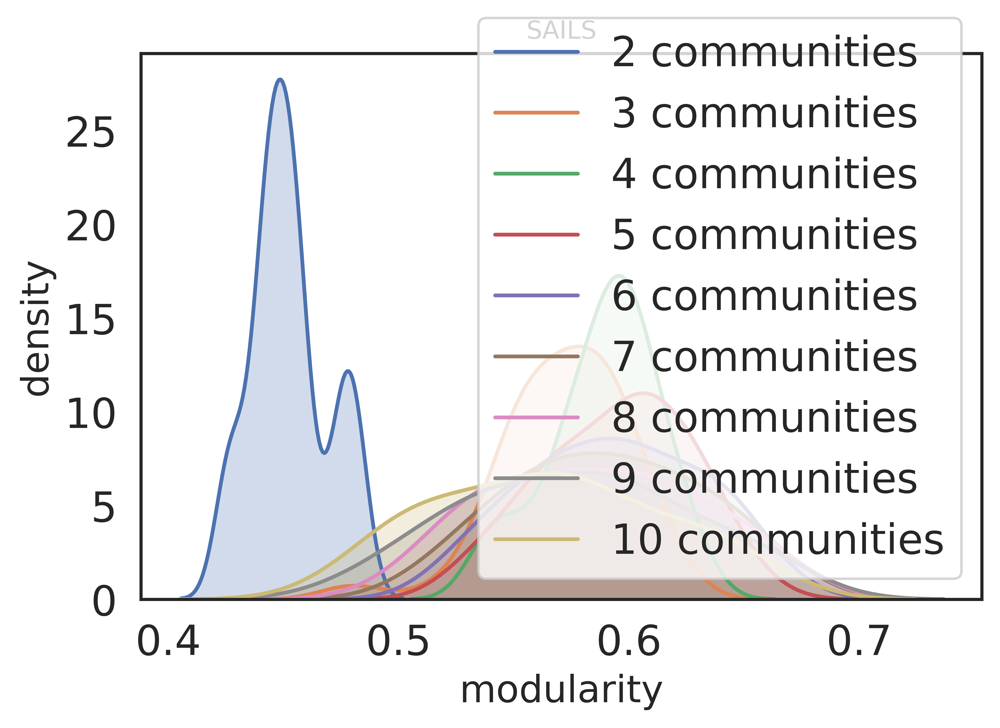

In [45]:
import seaborn as sns

fig, ax = plt.subplots(dpi=800)

for key in modularity.keys():

    sns.kdeplot(modularity[key],shade=True,label=str(key)+' communities')
plt.title('SAILS',fontsize=10)
plt.ylabel(r'density',fontsize=15)
plt.xlabel(r'modularity',fontsize=15)
plt.savefig('modularity_sails.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=800)
#plt.legend(loc='best',fontsize=5)
plt.rcParams.update({'font.size': 10,'legend.fontsize': 7})
plt.rcParams.update({'font.size': 10})
plt.show()

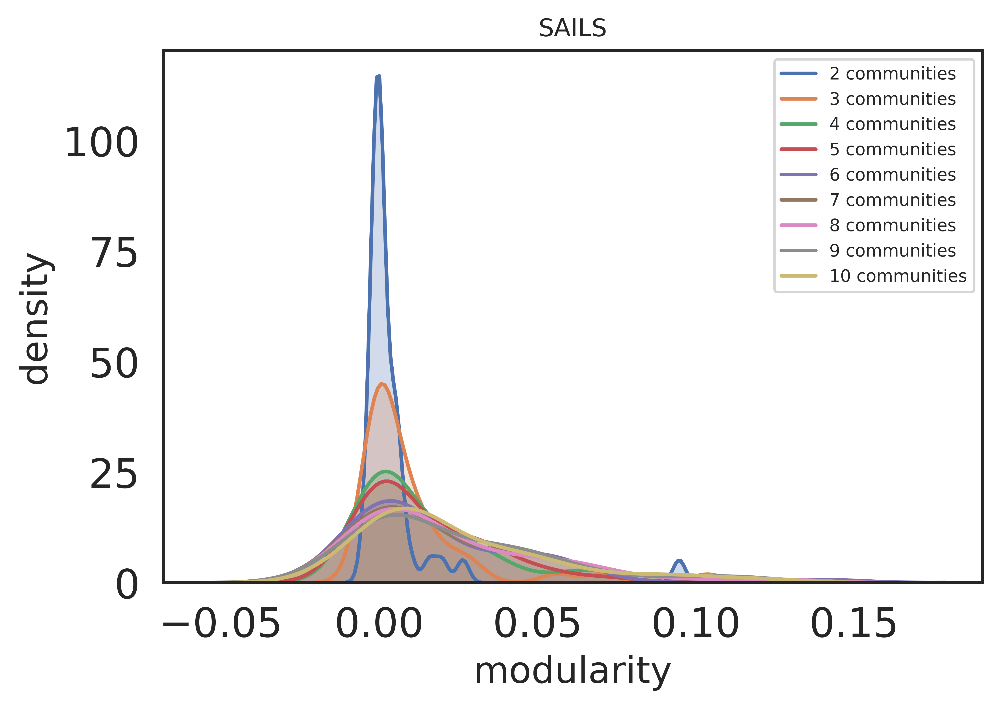

In [46]:
fig, ax = plt.subplots(dpi=800)

for key in modularity_random.keys():

    sns.kdeplot(modularity_random[key],shade=True,label=str(key)+' communities')
plt.title('SAILS',fontsize=10)
plt.ylabel(r'density',fontsize=15)
plt.xlabel(r'modularity',fontsize=15)
plt.savefig('modularity_sails_random.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=800)
#plt.legend(loc='best',fontsize=5)
plt.rcParams.update({'font.size': 10,'legend.fontsize': 7})
plt.show()

In [47]:
## miremos arawak!
from collections import defaultdict

arawak_size = {i:[] for i in range(9)}

for f in graphs.keys():
    for knn in graphs[f].keys():
        label_list = GN_dict[f][knn][0]
        G=graphs[f][knn]
        n = len([node for node in G.nodes if id_family[node]=='araw1281'])
        
        for D in label_list:
            v = defaultdict(list)
            for key, value in sorted(D.items()):
                v[value].append(key)
            v=dict(v)
            v = {key:[item for item in v[key] if item in id_family.keys() and id_family[item]=='araw1281'] for key in v.keys()}
            v = {key:float(len(v[key])/n) for key in v.keys()}
            arawak_size[label_list.index(D)]+=[max(list(v.values()))]

In [48]:
arawak_all = {'clusters':[], 'arawak':[]}

for key in arawak_size.keys():
    for item in arawak_size[key]:
        arawak_all['clusters']+=[key+2]
        arawak_all['arawak']+=[item]

In [49]:
arawak_mean = {key+2:np.mean(arawak_size[key]) for key in arawak_size.keys()}

In [50]:
arawak_mean

{2: 0.9992424242424243,
 3: 0.9992424242424243,
 4: 0.9859611742424242,
 5: 0.963873106060606,
 6: 0.9031556372549019,
 7: 0.8393171340505899,
 8: 0.7898625965537731,
 9: 0.7316730859010271,
 10: 0.6464531873355402}

In [51]:
import pandas as pd

arawak_all=pd.DataFrame.from_dict(arawak_all)

                            WLS Regression Results                            
Dep. Variable:                 arawak   R-squared:                       0.432
Model:                            WLS   Adj. R-squared:                  0.430
Method:                 Least Squares   F-statistic:                     272.0
Date:                Mon, 19 Oct 2020   Prob (F-statistic):           7.44e-46
Time:                        12:53:23   Log-Likelihood:                 210.57
No. Observations:                 360   AIC:                            -417.1
Df Residuals:                     358   BIC:                            -409.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      1.1463      0.018     63.591      0.0

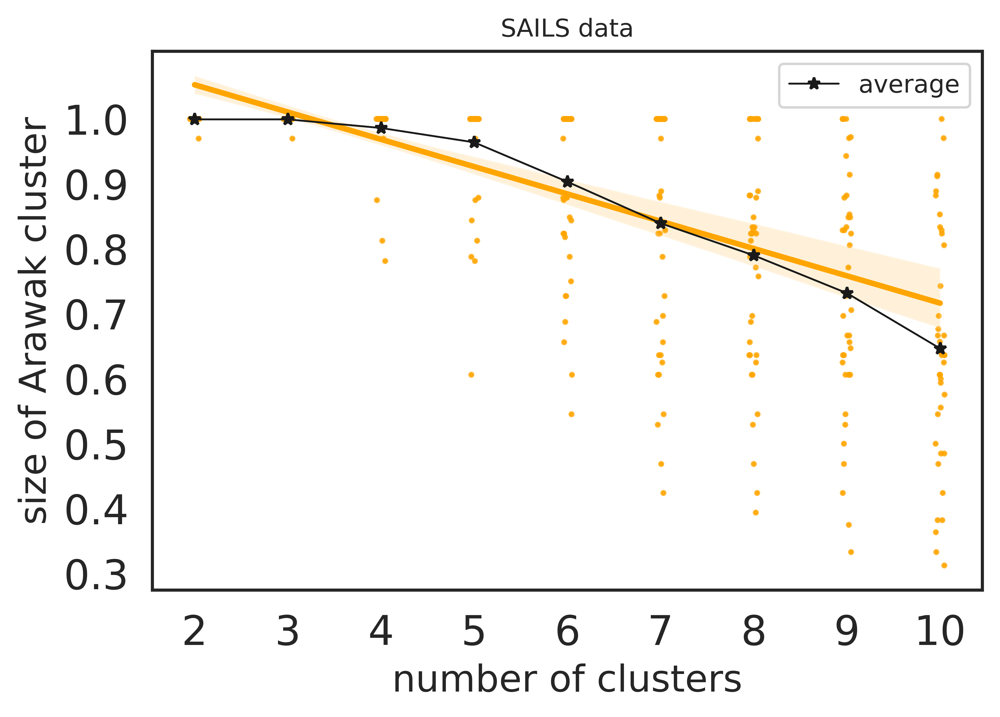

In [52]:
import statsmodels.formula.api as sm

data=arawak_all

result = sm.wls(formula='arawak ~ clusters', data=data).fit()
print(result.summary())

fig, ax = plt.subplots(dpi=800)

sns.set(font_scale=1.5,style="white")
sns.regplot(x='clusters',y='arawak',data=data,scatter_kws={'s':2},color='orange',scatter=True,robust=True,fit_reg=True,x_jitter=.05)
ax.plot(list(arawak_mean.keys()), list(arawak_mean.values()), linewidth=0.75, linestyle='-', marker='*',color='k',markersize=5,markeredgecolor='k',markeredgewidth=1,fillstyle='full',clip_on=True,label='average')
plt.xticks([2,3,4,5,6,7,8,9,10])
plt.yticks([0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0])
plt.title('SAILS data',fontsize=10)
plt.legend(loc='best',fontsize=10)
plt.xlabel(r'number of clusters',fontsize=15)
plt.ylabel(r'size of Arawak cluster',fontsize=15)
plt.savefig('arawak.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=800)
plt.rcParams.update({'font.size': 10})
plt.show()

### **5. Maximización de modularidad!**

La **[modularidad](https://www.pnas.org/content/103/23/8577)** se basa en la idea que **un grafo aleatorio no tiene estructura de clusters.** De esta forma, la posible existencia de clusters se revela mediante la comparación entre la densidad de aristas y las conexiones establecidas por algún modelo aleatorio nulo. Una primera definición de **modularidad** está dada por la siguiente relación:

$$Q=\frac{1}{2m}\sum_{ij}[A_{ij}-P_{ij}]\delta(c_i,c_j)$$

donde suma se realiza sobre todos los pares de nodos $ij$, $A$ es la matriz de adyacencia y $\delta(c_i,c_j)$ es 1 si los nodos $i$ y $j$ pertenecen a la misma comunidad. 

En la definición anterior, elegimos $P_{ij}$ como el número esperado de aristas entre los nodos $i$ y $j$, es decir

$$P_{ij}=\frac{k_ik_j}{2m}$$

**[Maximización de modularidad](https://journals.aps.org/pre/abstract/10.1103/PhysRevE.70.066111)**. Consideremos un grafo $G$ con $n$ nodos. Este algoritmo sigue esencialmente los siguientes pasos:

1. Comenzamos con $n$ clusters, cada uno formado por 1 nodo. 
2. Añadimos una primera arista, que disminuye el número de clusters de $n$ a $n-1$. La idea es elegir la arista de tal forma que obtengamos el máximo incremente en modularidad. 
3. Continuamos!

In [122]:
G = graphs[50][5]

In [123]:
from networkx.algorithms.community import greedy_modularity_communities

c = list(greedy_modularity_communities(G))

In [124]:
len(c)

5

In [125]:
M = community.modularity(G, c)

In [126]:
M

0.6098987855061172

In [127]:
for key in graphs.keys():
    for knn in graphs[key].keys():
        G=graphs[key][knn]
        c = list(greedy_modularity_communities(G))
        M = community.modularity(G, c)
        print(key,knn,len(c),M)

30 3 9 0.6297223897657808
30 4 8 0.6115316060599485
30 5 6 0.6157927604931787
30 6 5 0.5859116504553913
30 7 5 0.5809341152853928
40 3 7 0.6606686586289092
40 4 7 0.6269357556086604
40 5 6 0.631638571538627
40 6 5 0.6007355243659702
40 7 4 0.5932154894534639
50 3 7 0.6469195340083119
50 4 8 0.6070177764313075
50 5 5 0.6098987855061172
50 6 5 0.6015266781362548
50 7 5 0.5845929711402595
60 3 8 0.6357201908111484
60 4 6 0.6068459906653991
60 5 4 0.5632684932062025
60 6 5 0.5752416439728391
60 7 4 0.5593028937308511
70 3 7 0.6163271481170951
70 4 5 0.5876184671042323
70 5 5 0.567896374698208
70 6 5 0.5678689613375641
70 7 4 0.5460968689922826
80 3 8 0.6249973121599092
80 4 6 0.5538110642909311
80 5 5 0.5576583004386048
80 6 4 0.5723683882626648
80 7 4 0.5466607938362155
90 3 7 0.641488368050698
90 4 5 0.5940839688295817
90 5 4 0.5684215848930848
90 6 5 0.5483784588844061
90 7 4 0.5560392646179344
100 3 7 0.655826047021901
100 4 5 0.6031506102838723
100 5 5 0.5370139588813688
100 6 4 0.549

In [59]:
labels_nodes = {}
k = len(c)

for i in range(k):
    label = c[i]
    for node in label:
        labels_nodes[node]=i

In [120]:
def plot_MM(G,labels):
    fig, ax = plt.subplots(dpi=1080)
    
    #partition = community_louvain.best_partition(G,weight='none',partition={key:id_family[key] for key in G.nodes()})

    pos = nx.nx_pydot.graphviz_layout(G)#nx.kamada_kawai_layout(G)
    ## 
    nodesA = [node for node in G.nodes() if id_family[node]=='araw1281']
    nodesM = [node for node in G.nodes() if id_family[node]=='maya1287']
    nodesQ = [node for node in G.nodes() if id_family[node]=='quec1387']
    nodesP = [node for node in G.nodes() if id_family[node]=='pano1259']
    nodesO = [node for node in G.nodes() if id_family[node]=='otom1299']
    nodesT = [node for node in G.nodes() if id_family[node]=='tupi1275']
    nodesN = [node for node in G.nodes() if id_family[node]=='nucl1710']
    nodesC = [node for node in G.nodes() if id_family[node]=='cari1283']
    nodesU = [node for node in G.nodes() if id_family[node]=='utoa1244']
    nodesCh= [node for node in G.nodes() if id_family[node]=='chib1249']
    nodesB= [node for node in G.nodes() if id_family[node]=='barb1265']
    nodesAy= [node for node in G.nodes() if id_family[node]=='ayma1253']
    nodesAr= [node for node in G.nodes() if id_family[node]=='arau1255']
    nodesCho= [node for node in G.nodes() if id_family[node]=='chon1288']
    nodesMa= [node for node in G.nodes() if id_family[node]=='mata1289']
    nodesGu= [node for node in G.nodes() if id_family[node]=='guai1249']
    nodesZa= [node for node in G.nodes() if id_family[node]=='zamu1243']

    #nodesnonA = [node for node in G.nodes() if id_family[node] not in ['araw1281','maya1287','quec1387','pano1259','otom1299','tupi1275','nucl1710','cari1283','utoa1244']]
    
    nx.draw_networkx_nodes(G, pos, nodelist=nodesA, node_size = 40, node_color='orange',node_shape='H',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='araw1281') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesM, node_size = 40, node_color='m',node_shape='X', markeredgecolor='k',alpha=0.95,fillstyle='full',linewidths=0.1,label='maya1287') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesQ, node_size = 40, node_color='b',node_shape='o',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='quec1387') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesP, node_size = 40, node_color='r',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='pano1259') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesO, node_size = 40, node_color='cyan',node_shape='D',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='otom1299') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesT, node_size = 40, node_color='yellow',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='tupi1275') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesN, node_size = 40, node_color='green',node_shape='^',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='nucl1710') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesC, node_size = 40, node_color='olive',node_shape='v',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='cari1283') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesU, node_size = 40, node_color='lime',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='utoa1244') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCh, node_size = 40, node_color='crimson',node_shape='<',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chib1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesB, node_size = 40, node_color='chocolate',node_shape='>',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='barb1265') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAy, node_size = 40, node_color='slategrey',node_shape='d',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='ayma1253') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAr, node_size = 40, node_color='fuchsia',node_shape='8',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='arau1255') 
    ##
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCho, node_size = 40, node_color='palegreen',node_shape='h',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chon1288') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesMa, node_size = 40, node_color='steelblue',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='mata1289') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesGu, node_size = 40, node_color='salmon',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='guai1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesZa, node_size = 40, node_color='gold',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='zamu1243') 

    nx.draw_networkx_edges(G, pos, alpha=0.5,width=0.15,edge_color='lightblue')
    labels=labels
    nx.draw_networkx_labels(G,pos,labels,alpha=0.95,font_size=4,font_color='k',font_family='monospace')
    plt.title(r'Max modularity!',fontsize=10)
    plt.legend(loc='best',fontsize=5)
    plt.axis('off')
    #plt.savefig('GRAPHS/girvan-newman.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=1080)
    plt.show()

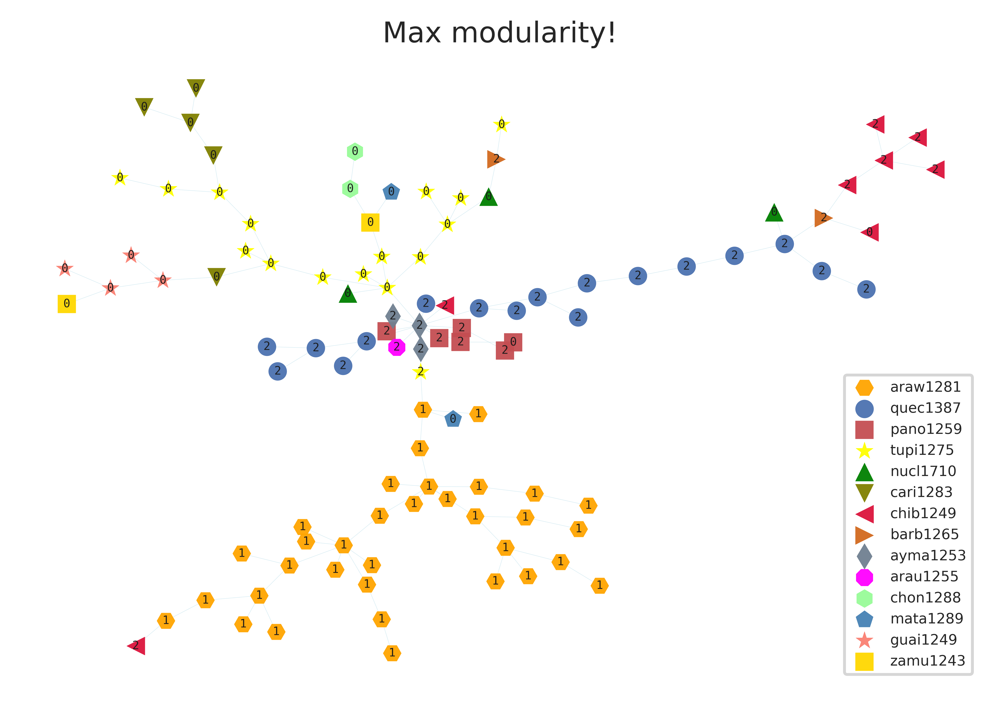

In [121]:
plot_MM(G,labels_nodes)

### **6. Algoritmo de Louvain!** 

Usemos una figura para explicar la idea del **[algoritmo](https://arxiv.org/pdf/0803.0476.pdf)!**

![Esquema](louvain.png)

In [111]:
G=graphs[50][3]
G=nx.maximum_spanning_tree(G)

In [112]:
partition = community_louvain.best_partition(G,resolution=2)

In [110]:
for key in graphs.keys():
    for knn in graphs[key].keys():
        G=graphs[key][knn]
        G=nx.maximum_spanning_tree(G)
        partition = community_louvain.best_partition(G,resolution=4)
        M = community_louvain.modularity(partition,G)
        print(key,knn,len(set(partition.values())),M)

30 3 6 0.7741582984839334
30 4 6 0.7741582984839334
30 5 6 0.7741582984839332
30 6 5 0.7411869484155374
30 7 6 0.7741582984839334
40 3 6 0.7768432340628365
40 4 5 0.7550917988062923
40 5 6 0.7760510830882338
40 6 6 0.7760510830882338
40 7 6 0.7760510830882338
50 3 6 0.7685600716012382
50 4 6 0.7841633763893653
50 5 6 0.7833436316365814
50 6 6 0.7833436316365814
50 7 6 0.7833436316365814
60 3 5 0.7545379334408143
60 4 5 0.7533936981221172
60 5 5 0.7528557373854656
60 6 5 0.7528557373854657
60 7 5 0.7528557373854655
70 3 4 0.7056251010591127
70 4 4 0.7063590239364533
70 5 4 0.7063590239364534
70 6 4 0.7063590239364536
70 7 4 0.7063590239364533
80 3 5 0.7416608181593594
80 4 5 0.7398907895886355
80 5 5 0.7402029568933925
80 6 5 0.7398907895886355
80 7 5 0.7398907895886354
90 3 5 0.7486198266912698
90 4 5 0.7272438038869543
90 5 5 0.7344129409527725
90 6 5 0.7272133027076559
90 7 5 0.7272133027076559
100 3 4 0.6903877553884896
100 4 4 0.6903856131498312
100 5 4 0.7046587576872625
100 6 4 0

In [113]:
def plot_L(G,labels):
    fig, ax = plt.subplots(dpi=1080)
    
    #partition = community_louvain.best_partition(G,weight='none',partition={key:id_family[key] for key in G.nodes()})

    pos = nx.nx_pydot.graphviz_layout(G)#nx.kamada_kawai_layout(G)
    ## 
    nodesA = [node for node in G.nodes() if id_family[node]=='araw1281']
    nodesM = [node for node in G.nodes() if id_family[node]=='maya1287']
    nodesQ = [node for node in G.nodes() if id_family[node]=='quec1387']
    nodesP = [node for node in G.nodes() if id_family[node]=='pano1259']
    nodesO = [node for node in G.nodes() if id_family[node]=='otom1299']
    nodesT = [node for node in G.nodes() if id_family[node]=='tupi1275']
    nodesN = [node for node in G.nodes() if id_family[node]=='nucl1710']
    nodesC = [node for node in G.nodes() if id_family[node]=='cari1283']
    nodesU = [node for node in G.nodes() if id_family[node]=='utoa1244']
    nodesCh= [node for node in G.nodes() if id_family[node]=='chib1249']
    nodesB= [node for node in G.nodes() if id_family[node]=='barb1265']
    nodesAy= [node for node in G.nodes() if id_family[node]=='ayma1253']
    nodesAr= [node for node in G.nodes() if id_family[node]=='arau1255']
    nodesCho= [node for node in G.nodes() if id_family[node]=='chon1288']
    nodesMa= [node for node in G.nodes() if id_family[node]=='mata1289']
    nodesGu= [node for node in G.nodes() if id_family[node]=='guai1249']
    nodesZa= [node for node in G.nodes() if id_family[node]=='zamu1243']

    #nodesnonA = [node for node in G.nodes() if id_family[node] not in ['araw1281','maya1287','quec1387','pano1259','otom1299','tupi1275','nucl1710','cari1283','utoa1244']]
    
    nx.draw_networkx_nodes(G, pos, nodelist=nodesA, node_size = 40, node_color='orange',node_shape='H',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='araw1281') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesM, node_size = 40, node_color='m',node_shape='X', markeredgecolor='k',alpha=0.95,fillstyle='full',linewidths=0.1,label='maya1287') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesQ, node_size = 40, node_color='b',node_shape='o',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='quec1387') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesP, node_size = 40, node_color='r',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='pano1259') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesO, node_size = 40, node_color='cyan',node_shape='D',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='otom1299') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesT, node_size = 40, node_color='yellow',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='tupi1275') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesN, node_size = 40, node_color='green',node_shape='^',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='nucl1710') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesC, node_size = 40, node_color='olive',node_shape='v',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='cari1283') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesU, node_size = 40, node_color='lime',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='utoa1244') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCh, node_size = 40, node_color='crimson',node_shape='<',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chib1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesB, node_size = 40, node_color='chocolate',node_shape='>',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='barb1265') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAy, node_size = 40, node_color='slategrey',node_shape='d',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='ayma1253') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAr, node_size = 40, node_color='fuchsia',node_shape='8',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='arau1255') 
    ##
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCho, node_size = 40, node_color='palegreen',node_shape='h',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chon1288') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesMa, node_size = 40, node_color='steelblue',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='mata1289') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesGu, node_size = 40, node_color='salmon',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='guai1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesZa, node_size = 40, node_color='gold',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='zamu1243') 

    nx.draw_networkx_edges(G, pos, alpha=0.5,width=0.15,edge_color='lightblue')
    labels=labels
    nx.draw_networkx_labels(G,pos,labels,alpha=0.95,font_size=4,font_color='k',font_family='monospace')
    plt.title(r'Louvain!',fontsize=10)
    plt.legend(loc='best',fontsize=5)
    plt.axis('off')
    #plt.savefig('GRAPHS/girvan-newman.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=1080)
    plt.show()

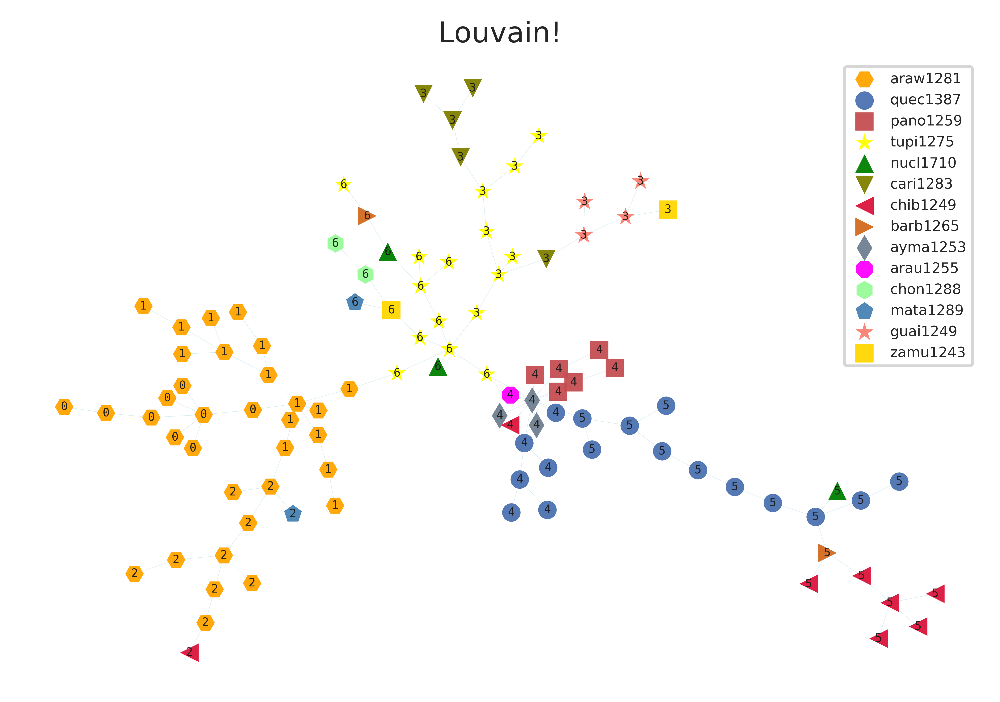

In [114]:
plot_L(G,partition)

In [66]:
M = community_louvain.modularity(partition,G)

In [67]:
len(set(partition.values()))

3

In [68]:
M

0.5943051317781916

In [69]:
M_graphs = []
C_graphs = []

for key in graphs.keys():
    for knn in graphs[key].keys():
        G=graphs[key][knn]
        partition = community_louvain.best_partition(G,resolution=2.3)
        C_graphs.append(len(set(partition.values())))
        M_graphs.append(community_louvain.modularity(partition,G))

In [70]:
M_graphs

[0.6110059785286635,
 0.5710090697806577,
 0.5925305366804043,
 0.5831612694513775,
 0.5760741663385135,
 0.6190628785737257,
 0.6056298030668925,
 0.6130486523718411,
 0.599485912331665,
 0.5941874160930551,
 0.6069477213288309,
 0.5951597335289218,
 0.588043832601994,
 0.5874657478552178,
 0.5800233983054527,
 0.5907088166498307,
 0.5833250669328709,
 0.5693802935456405,
 0.5699034930871512,
 0.5543127546569133,
 0.5940562760389098,
 0.5505346348489031,
 0.5612582350584426,
 0.5478854524635655,
 0.5411060197610631,
 0.5805269057346175,
 0.5713715483608517,
 0.5613282726314702,
 0.5509723573951044,
 0.5447210669940007,
 0.5896962028020851,
 0.5671714535463592,
 0.47499283079162435,
 0.5499905237559553,
 0.4559159676391744,
 0.6341504038203241,
 0.5758877751730904,
 0.4766899644944905,
 0.4783534523170354,
 0.47778701933106266]

In [71]:
C_graphs

[4,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 4,
 3,
 2,
 3,
 2,
 4,
 3,
 2,
 2,
 2]

### **7. Representaciones de baja dimensión**

Los grafos pueden parecer una **maraña de alta dimensionalidad**. En este sentido, siempre es útil, en una primera aproximación, intentar borrar ciertos nodos o arista de poca importancia. Otra manera de solucionar esto es **representar los nodos de un grafo como vectores.** Esto permite, como sabemos, aplicar técnicas de machine learning con el fin de **extraer información de los grafos.** 

#### **clustering spectral**

No debería sorprendernos que la matriz de adyacencia de un grafo permite identificar comunidades. Como hemos visto, tenemos grafos que indican la similaridad entre lenguas. Cada grafo $G$ tiene asociada una **matriz de adyacencia $A$.** Otra matriz importante en este espacio en la **matriz de grado $D$**, la que en su diagonal contiene los grados de los nodos de $G$. La **matriz laplaciana** se define como $D-A$. Esta matriz tiene muchas propiedades mágicas, entre ellas 

- simétrica
- semi-definida positiva

A partir de estas mini-propiedades, sabemos que todos sus valores propios son reales y no-negativos. Les recomiendo el siguiente **[link](https://www.researchgate.net/publication/309153198_NumPy_SciPy_NetworkX_Recipes_for_Data_Science_Spectral_Clustering?channel=doi&linkId=5801026908ae310e0d98aa5f&showFulltext=true).**

In [72]:
G=graphs[50][5]

In [73]:
import numpy.linalg as la
import scipy.cluster.vq as vq
import numpy as np

## matriz de adyacencia de G
A = nx.adjacency_matrix(G)#,weight='weight')
D = np.diag(np.ravel(np.sum(A,axis=1)))
## calculemos L
L = D - A
## valores y vectores propios
l, U = la.eigh(L)
## el segundo vector propio nos da una idea de la estructura de clusters!
f = U[:,1]
k = 3
## nos quedamos con las k primeras componentes y aplicamos kmeans!
means, labels = vq.kmeans2(U[:,1:k], k)
## diccionario de nodos y labels
labels_nodes=dict(zip(G.nodes(),labels))

In [74]:
def plot_spec(G):
    fig, ax = plt.subplots(dpi=1080)
    
    #partition = community_louvain.best_partition(G,weight='none',partition={key:id_family[key] for key in G.nodes()})

    pos = nx.nx_pydot.graphviz_layout(G)#nx.kamada_kawai_layout(G)
    ## 
    nodesA = [node for node in G.nodes() if id_family[node]=='araw1281']
    nodesM = [node for node in G.nodes() if id_family[node]=='maya1287']
    nodesQ = [node for node in G.nodes() if id_family[node]=='quec1387']
    nodesP = [node for node in G.nodes() if id_family[node]=='pano1259']
    nodesO = [node for node in G.nodes() if id_family[node]=='otom1299']
    nodesT = [node for node in G.nodes() if id_family[node]=='tupi1275']
    nodesN = [node for node in G.nodes() if id_family[node]=='nucl1710']
    nodesC = [node for node in G.nodes() if id_family[node]=='cari1283']
    nodesU = [node for node in G.nodes() if id_family[node]=='utoa1244']
    nodesCh= [node for node in G.nodes() if id_family[node]=='chib1249']
    nodesB= [node for node in G.nodes() if id_family[node]=='barb1265']
    nodesAy= [node for node in G.nodes() if id_family[node]=='ayma1253']
    nodesAr= [node for node in G.nodes() if id_family[node]=='arau1255']
    nodesCho= [node for node in G.nodes() if id_family[node]=='chon1288']
    nodesMa= [node for node in G.nodes() if id_family[node]=='mata1289']
    nodesGu= [node for node in G.nodes() if id_family[node]=='guai1249']
    nodesZa= [node for node in G.nodes() if id_family[node]=='zamu1243']

    #nodesnonA = [node for node in G.nodes() if id_family[node] not in ['araw1281','maya1287','quec1387','pano1259','otom1299','tupi1275','nucl1710','cari1283','utoa1244']]
    
    nx.draw_networkx_nodes(G, pos, nodelist=nodesA, node_size = 40, node_color='orange',node_shape='H',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='araw1281') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesM, node_size = 40, node_color='m',node_shape='X', markeredgecolor='k',alpha=0.95,fillstyle='full',linewidths=0.1,label='maya1287') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesQ, node_size = 40, node_color='b',node_shape='o',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='quec1387') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesP, node_size = 40, node_color='r',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='pano1259') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesO, node_size = 40, node_color='cyan',node_shape='D',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='otom1299') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesT, node_size = 40, node_color='yellow',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='tupi1275') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesN, node_size = 40, node_color='green',node_shape='^',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='nucl1710') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesC, node_size = 40, node_color='olive',node_shape='v',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='cari1283') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesU, node_size = 40, node_color='lime',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='utoa1244') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCh, node_size = 40, node_color='crimson',node_shape='<',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chib1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesB, node_size = 40, node_color='chocolate',node_shape='>',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='barb1265') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAy, node_size = 40, node_color='slategrey',node_shape='d',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='ayma1253') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesAr, node_size = 40, node_color='fuchsia',node_shape='8',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='arau1255') 
    ##
    nx.draw_networkx_nodes(G, pos, nodelist=nodesCho, node_size = 40, node_color='palegreen',node_shape='h',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='chon1288') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesMa, node_size = 40, node_color='steelblue',node_shape='p',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='mata1289') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesGu, node_size = 40, node_color='salmon',node_shape='*',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='guai1249') 
    nx.draw_networkx_nodes(G, pos, nodelist=nodesZa, node_size = 40, node_color='gold',node_shape='s',markeredgecolor='k',alpha=0.95,fillstyle='full', linewidths=0.1,label='zamu1243') 

    nx.draw_networkx_edges(G, pos, alpha=0.5,width=0.15,edge_color='lightblue')
    labels=labels_nodes
    nx.draw_networkx_labels(G,pos,labels,alpha=0.95,font_size=4,font_color='k',font_family='monospace')
    plt.title(r'spectral representation $+$ kmeans',fontsize=10)
    plt.legend(loc='best',fontsize=5)
    plt.axis('off')
    plt.savefig('GRAPHS/graph_spectral.pdf', format='pdf', transparent=True, bbox_inches='tight',dpi=1080)
    plt.show()

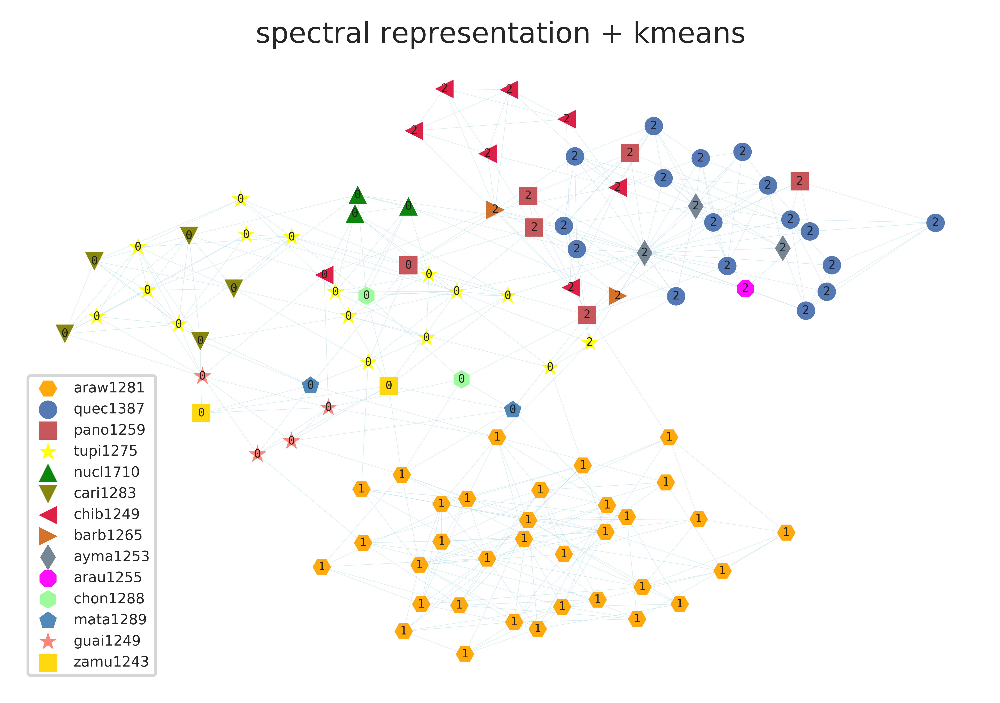

In [75]:
plot_spec(G)